In [7]:
import pandas as pd
import numpy as np

In [8]:
df = pd.read_excel('data.xlsx')

In [9]:
df

,ВремяГТИ,Глубина БК,"Блок, м","Вес, т","Расход, л/с","Давление, атм"
0,2022-01-18 12:00:00,13.29,8.16,0.00,0.0,0.0
1,2022-01-18 12:00:05,13.29,8.38,0.00,0.0,0.0
2,2022-01-18 12:00:10,13.29,8.57,0.37,0.0,0.0
3,2022-01-18 12:00:15,13.29,8.57,0.23,0.0,0.0
4,2022-01-18 12:00:20,13.29,8.67,0.00,0.0,0.0
...,...,...,...,...,...,...
55321,2022-01-22 02:25:05,2531.66,2.21,0.00,0.0,0.0
55322,2022-01-22 02:25:10,2531.66,2.21,0.00,0.0,0.0
55323,2022-01-22 02:25:15,2531.66,2.22,0.00,0.0,0.0
55324,2022-01-22 02:25:20,2531.63,2.29,37.17,0.0,0.0


## Задание 2
_______________________

In [10]:
time_up = 0
time_down = 0
velocity_sum_up = 0
velocity_sum_down = 0
counter_up = 0
counter_down = 0
df['ВремяГТИ'] = pd.to_datetime(df['ВремяГТИ'])


velos_up = []
velos_down = []
velocity = [0]*df.shape[0]
time_up = []
time_down = []

for i in range(1, df.shape[0]):
    delta = df['Глубина БК'][i]-df['Глубина БК'][i-1]
    delta_time  = (df['ВремяГТИ'][i]-df['ВремяГТИ'][i-1]).total_seconds()
    if delta>0.1:
        velos_down.append(delta)
        time_down.append(delta_time)
    elif delta<-0.1:
        velos_up.append(-delta)
        time_up.append(delta_time)
    velocity[i] = delta/delta_time

avg_up = sum(velos_up)/sum(time_up)
avg_down = sum(velos_down)/sum(time_down)
df['velocity'] = velocity

print(f'средняя скорость спуска: {avg_down}')
print(f'средняя скорость подъема: {np.abs(avg_up)}')  
data= {'Средняя скорость спуска': [avg_down], 'Средняя скорость подъема': [avg_up]}
dataset = pd.DataFrame(data=data)
dataset.to_excel('result.xlsx', index=False)

средняя скорость спуска: 0.042588715738432203
средняя скорость подъема: 0.04910004519246356


## Задание 3
_______________________

In [14]:
df_origin = df

for i in range(1, df.shape[0]):
    if np.abs(df['Глубина БК'][i] - df['Глубина БК'][i-1])<0.1:
        df.loc[i,'Глубина БК'] = df['Глубина БК'][i-1]
print('max = ',df_origin['Вес, т'].max())
print('min = ',df_origin['Вес, т'].min())
print('mean = ',df_origin['Вес, т'].mean())



max =  224.16
min =  0.0
mean =  30.130160322452372


In [19]:
df1 = df.groupby('Глубина БК')[['Вес, т']].mean()



In [20]:
df1

,"Вес, т"
Глубина БК,
0.00,0.913852
4.00,0.147532
12.80,0.076243
13.29,0.069091
15.00,0.467094
...,...
2544.39,203.470000
2544.65,153.460000
2544.79,157.276667


Text(0.5, 1.0, 'Глубина от среднего веса на труб')

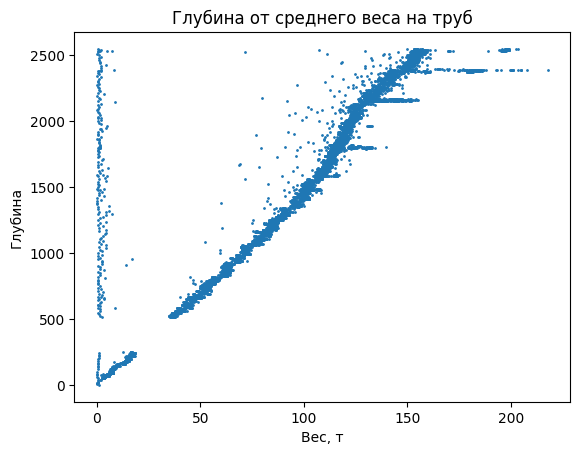

In [22]:
import matplotlib.pyplot as plt

plt.scatter(df1['Вес, т'], df1.index, s=1)
plt.xlabel('Вес, т')
plt.ylabel('Глубина')
plt.title('Глубина от среднего веса на труб')

In [33]:
import plotly.express as px

In [36]:
fig = px.scatter(x=df['ВремяГТИ'],y=df['Вес, т'], trendline="ols",
                 trendline_color_override="red", 
                 title='Вес блока от времени',
                labels = {'x': 'Время', 'y':'Вес'})

fig.show()

In [37]:
fig = px.scatter(x=df['ВремяГТИ'],y=df['Глубина БК'], trendline="ols",
                 trendline_color_override="red", 
                 title='Вес блока от времени',
                labels = {'x': 'Время', 'y':'Вес'})

fig.show()